<a href="https://colab.research.google.com/github/Amirrezahmi/Video-Inpainting-and-Voice-Cloning/blob/main/video%20inpainting/applying%20IS%20to%20video/applying_SAM_to_video_frames_approach2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Set up your environment
!pip install 'git+https://github.com/facebookresearch/segment-anything.git'
!pip install -q roboflow supervision
!wget -q 'https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth'

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-8krhqhuy
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-8krhqhuy
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36588 sha256=4bd16d5b4dcde78ef701755c40939d67b1eb70f26227efce1f387d19d3f6de0e
  Stored in directory: /tmp/pip-ephem-wheel-cache-z_b9c_92/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 kB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.2/72.2 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 14.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
!pip install transformers

In [28]:
!pip install moviepy

In [49]:
!pip install pydub

In [3]:
import torch
import numpy as np
from PIL import Image
import cv2
import os
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
import matplotlib.pyplot as plt

# Set up SAM model as before
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"
CHECKPOINT_PATH = 'sam_vit_h_4b8939.pth'
sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH)
sam.to(device=DEVICE)

mask_generator = SamAutomaticMaskGenerator(sam)

In [4]:
def video_to_frames(video_path, frames_dir):
    video = cv2.VideoCapture(video_path)
    count = 0
    while video.isOpened():
        ret, frame = video.read()
        if not ret:
            break
        cv2.imwrite(frames_dir + "/{:d}.png".format(count), frame)
        count += 1
    video.release()
    #cv2.destroyAllWindows()
    return count

In [5]:
frames_count_1 = video_to_frames('/content/video1.mp4', '/content/file12')
#frames_count_2 = video_to_frames('/content/video2.mp4', '/content/file16')

In [6]:
frames_count_2 = video_to_frames('/content/video2.mp4', '/content/file16')

In [7]:
import os
import shutil

# Define the directories
dir1 = '/content/file12'
dir2 = '/content/file16'

# Get the list of all files in directory 1
files_dir1 = set(os.listdir(dir1))

# Get the list of all files in directory 2
files_dir2 = set(os.listdir(dir2))

# Find the files which are in directory 2 but not in directory 1
files_to_delete = files_dir2 - files_dir1

# Remove these files from directory 2
for file in files_to_delete:
    file_path = os.path.join(dir2, file)
    if os.path.isfile(file_path):
        os.remove(file_path)

In [8]:
import os
import shutil

# Define the directories
dir2 = '/content/file12'
dir1 = '/content/file16'

# Get the list of all files in directory 1
files_dir1 = set(os.listdir(dir1))

# Get the list of all files in directory 2
files_dir2 = set(os.listdir(dir2))

# Find the files which are in directory 2 but not in directory 1
files_to_delete = files_dir2 - files_dir1

# Remove these files from directory 2
for file in files_to_delete:
    file_path = os.path.join(dir2, file)
    if os.path.isfile(file_path):
        os.remove(file_path)

In [9]:
import os

# Specify the folder where your images are located
folder_path = '/content/file12'

# List all files in the folder
files = os.listdir(folder_path)

# Sort the files by their numerical names
sorted_files = sorted(files, key=lambda x: int(x.split('.')[0]))

# Now, sorted_files contains your image filenames in numerical order
print(sorted_files)

['0.png', '1.png', '2.png', '3.png', '4.png', '5.png', '6.png', '7.png', '8.png', '9.png', '10.png', '11.png', '12.png', '13.png', '14.png', '15.png', '16.png', '17.png', '18.png', '19.png', '20.png', '21.png', '22.png', '23.png', '24.png', '25.png', '26.png', '27.png', '28.png', '29.png', '30.png', '31.png', '32.png', '33.png', '34.png', '35.png', '36.png', '37.png', '38.png', '39.png', '40.png', '41.png', '42.png', '43.png', '44.png', '45.png', '46.png', '47.png', '48.png', '49.png', '50.png', '51.png', '52.png', '53.png', '54.png', '55.png', '56.png', '57.png', '58.png', '59.png', '60.png', '61.png', '62.png', '63.png', '64.png', '65.png', '66.png', '67.png', '68.png', '69.png', '70.png', '71.png', '72.png', '73.png', '74.png', '75.png', '76.png', '77.png', '78.png', '79.png', '80.png', '81.png', '82.png', '83.png', '84.png', '85.png', '86.png', '87.png', '88.png', '89.png', '90.png', '91.png', '92.png', '93.png', '94.png', '95.png', '96.png', '97.png', '98.png', '99.png', '100.png'

In [10]:
def display_masks(frames_dir1):
    # List all files in the folders
    files = os.listdir(frames_dir1)
    files.sort(key=lambda x: int(x.split('.')[0]))

    # Load the first image
    image_path1 = os.path.join(frames_dir1, files[0])
    image1 = Image.open(image_path1)
    image_np1 = np.array(image1)

    # Generate masks
    result = mask_generator.generate(image_np1)

    # Calculate the size of the grid based on the number of masks
    rows = int(np.ceil(np.sqrt(len(result))))
    cols = rows

    # Display the masks
    plt.figure(figsize=(20, 20))
    for i, segmentation in enumerate(result):
        plt.subplot(rows, cols, i+1)
        plt.imshow(segmentation['segmentation'], cmap='gray')
        plt.title(f"{i}")
    plt.show()

    return result

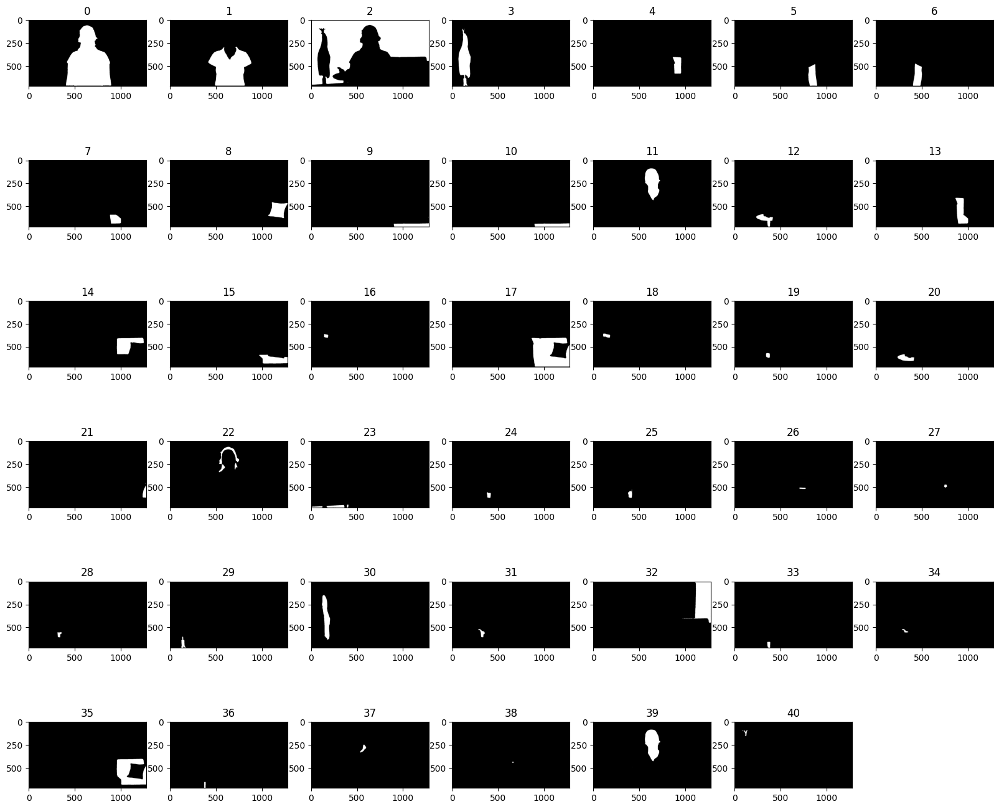

In [11]:
result = display_masks('/content/file12')

In [12]:
chosen_index = int(input("Enter the index of the mask to keep: "))

Enter the index of the mask to keep: 0


Second approach: compare every frame in the video with the first frame

In [13]:
def apply_sam_to_frames(frames_dir1, frames_dir2, output_dir, chosen_index):
    # List all files in the folders
    files = os.listdir(frames_dir1)
    files.sort(key=lambda x: int(x.split('.')[0]))

    # Initialize a binary mask with all zeros for the first frame
    first_binary_mask = None

    # Iterate over the sorted files
    for file in files:
        # Load the images
        image_path1 = os.path.join(frames_dir1, file)
        image_path2 = os.path.join(frames_dir2, file)
        image1 = Image.open(image_path1)
        image2 = Image.open(image_path2)
        image_np1 = np.array(image1)

        # Generate masks
        result = mask_generator.generate(image_np1)

        # If this is the first frame, set the chosen mask as the first mask
        if first_binary_mask is None:
            first_binary_mask = result[chosen_index]['segmentation']
            previous_binary_mask = first_binary_mask
        else:
            # Find the mask that most closely matches the first mask
            best_iou = 0
            for i, segmentation in enumerate(result):
                # Get the mask
                mask_array = segmentation['segmentation']

                # Calculate the Intersection over Union (IoU) with the first mask
                intersection = np.logical_and(first_binary_mask, mask_array).sum()
                union = np.logical_or(first_binary_mask, mask_array).sum()
                iou = intersection / union

                # If this mask has a higher IoU than the current best, make it the new best
                if iou > best_iou:
                    best_iou = iou
                    previous_binary_mask = mask_array

        # Convert the binary mask to uint8
        previous_binary_mask_uint8 = (previous_binary_mask * 255).astype(np.uint8)

        # Resize the mask to match the size of the frame
        previous_binary_mask_resized = cv2.resize(previous_binary_mask_uint8, (image2.width, image2.height), interpolation = cv2.INTER_NEAREST)

        # Resize image1 to match the size of image2
        image1_resized = image1.resize((image2.width, image2.height))

        # Create a transparent image
        transparent_image = Image.new("RGBA", image2.size, (0, 0, 0, 0))

        # Paste the resized image1 onto the transparent image using the resized binary mask
        transparent_image.paste(image1_resized, (0, 0), mask=Image.fromarray(previous_binary_mask_resized))

        # Overlay the transparent image onto the second frame
        image2.paste(transparent_image, (0, 0), transparent_image)

        # Save the output frame
        image2.save(os.path.join(output_dir, file))


In [14]:
apply_sam_to_frames('/content/file12', '/content/file16', '/content/out111', chosen_index)


In [26]:
from os.path import isfile, join
import re

def frames_to_video(inputpath, outputpath, fps):
    frame_array = []
    files = [f for f in os.listdir(inputpath) if isfile(join(inputpath, f))]
    files.sort(key=lambda f: int(re.sub('\D', '', f)))
    for i in range(len(files)):
        filename = join(inputpath, files[i])  # use os.path.join to create the full file path
        img = cv2.imread(filename)
        if img is None:
            print(f"Could not load image: {filename}")
            continue
        height, width, layers = img.shape
        size = (width, height)
        frame_array.append(img)
    out = cv2.VideoWriter(outputpath, cv2.VideoWriter_fourcc(*'DIVX'), fps, size)
    for i in range(len(frame_array)):
        out.write(frame_array[i])
    out.release()

frames_to_video('/content/out111', 'output_video.mp4', 30)

displaying video1:

In [16]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/video1.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

displaying video2:

In [17]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/video2.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

displaying the output:

In [27]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/output_video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

checking if videos have sound

In [29]:
import subprocess
import json

def has_audio_streams(file_path):
    command = ['ffprobe', '-show_streams',
               '-print_format', 'json', file_path]
    output = subprocess.check_output(command)
    parsed = json.loads(output)
    streams = parsed['streams']
    audio_streams = list(filter((lambda x: x['codec_type'] == 'audio'), streams))
    return len(audio_streams) > 0

In [30]:
has_audio_streams('/content/video1.mp4')

True

So video 1 has sound -> True

In [33]:
has_audio_streams('/content/video2.mp4')

True

So video 1 has sound -> True

In [34]:
has_audio_streams('/content/output_video.mp4')

False

So video 2 has sound -> False

Extracting rhe audios from videos

In [35]:
from moviepy.editor import VideoFileClip

def convert_video_to_audio_moviepy(video_file, output_ext="mp3"):
    clip = VideoFileClip(video_file)
    clip.audio.write_audiofile(f"/content/{video_file}.{output_ext}")

In [43]:
import subprocess
import os
import sys

def convert_video_to_audio_ffmpeg(video_file, output_ext="mp3"):
    """Converts video to audio directly using ffmpeg command
    with the help of subprocess module"""
    filename, ext = os.path.splitext(video_file)
    subprocess.call(["ffmpeg", "-y", "-i", video_file, f"{filename}.{output_ext}"],
                    stdout=subprocess.DEVNULL,
                    stderr=subprocess.STDOUT)

vf = sys.argv[1]
convert_video_to_audio_ffmpeg(vf)

In [44]:
convert_video_to_audio_ffmpeg('/content/video1.mp4')

In [45]:
from IPython.display import Audio
wn = Audio("/content/video1.mp3", autoplay=True)
display(wn)

In [46]:
convert_video_to_audio_ffmpeg('/content/video2.mp4')

In [47]:
wn = Audio("/content/video2.mp3", autoplay=True)
display(wn)

In [61]:
from pydub import AudioSegment

# Load the two audio files
vocal = AudioSegment.from_file("/content/video1.mp3", format="mp3")
instrumental = AudioSegment.from_file('/content/video2.mp3', format="mp3")

# Overlay the files
merged_song = vocal.overlay(instrumental)

# Export the result
merged_song.export("/content/output_export.wav", format="wav")

<_io.BufferedRandom name='/content/output_export.wav'>

Export the sounds extracted to video1 and video2 in one sound:

In [62]:
wn = Audio("/content/output_export.wav", autoplay=True)
display(wn)

we could also do the same thing wit .mp4 format .. it means we dont need to extract the sounds from videos

In [63]:
from pydub import AudioSegment

# Load the two audio files
vocal = AudioSegment.from_file("/content/video1.mp4", format="mp4")
instrumental = AudioSegment.from_file('/content/video2.mp4', format="mp4")

# Overlay the files
merged_song = vocal.overlay(instrumental)

# Export the result
merged_song.export("/content/output_export1.wav", format="wav")

<_io.BufferedRandom name='/content/output_export1.wav'>

In [64]:
wn = Audio("/content/output_export1.wav", autoplay=True)
display(wn)

now we add the output audio to the generated video:

In [65]:
from moviepy.editor import VideoFileClip, AudioFileClip

# Load video and audio files
video = VideoFileClip("/content/output_video.mp4")
audio = AudioFileClip("/content/output_export1.wav")

# Set the duration of the audio to match the video
audio = audio.set_duration(video.duration)

# Set audio of the video
video = video.set_audio(audio)

# Write the result to a file
video.write_videofile("/content/outputvideo.mp4")

chunk:  12%|█▏        | 27/222 [23:54<2:52:40, 53.13s/it, now=None]

Moviepy - Building video /content/outputvideo.mp4.
MoviePy - Writing audio in outputvideoTEMP_MPY_wvf_snd.mp3



chunk:  12%|█▏        | 27/222 [23:54<2:52:41, 53.14s/it, now=None]

MoviePy - Done.
Moviepy - Writing video /content/outputvideo.mp4




t:   0%|          | 0/226 [00:00<?, ?it/s, now=None]

t: 100%|█████████▉| 225/226 [00:26<00:00,  4.27it/s, now=None]
                                                              

Moviepy - Done !
Moviepy - video ready /content/outputvideo.mp4


In [66]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/outputvideo.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

Done!